# Init

In [ ]:
# !pip install "git+https://github.com/MannLabs/alphatims.git@develop#egg=alphatims[stable,plotting-stable,development-stable]"
# !pip install sklearn

In [1]:
%reload_ext autoreload
%autoreload 2

In [2]:
import alphatims.bruker
import alphatims.utils
import numpy as np
import pandas as pd
import scipy.ndimage
import colorcet
import hvplot.pandas
from matplotlib import pyplot as plt
import tqdm
import functools
import holoviews as hv

alphatims.utils.set_threads(7)
alphatims.utils.set_logger(log_file_name="sandbox_calibration_log.txt")

'/Users/swillems/Documents/software/alphadia/nbs/sandbox_calibration_log.txt'

# Function definitions

In [3]:
@alphatims.utils.njit(nogil=True, cache=False)
def merge_cyclic_pushes(
    cyclic_push_index,
    intensity_values,
    tof_indices,
    push_indptr,
    zeroth_frame,
    cycle_length,
    tof_max_index,
    scan_max_index,
    return_sparse=False,
):
    offset = scan_max_index * zeroth_frame + cyclic_push_index
    intensity_buffer = np.zeros(tof_max_index)
    tofs = []
    for push_index in range(offset, len(push_indptr) - 1, cycle_length):
        start = push_indptr[push_index]
        end = push_indptr[push_index + 1]
        for index in range(start, end):
            tof = tof_indices[index]
            intensity = intensity_values[index]
            if intensity_buffer[tof] == 0:
                tofs.append(tof)
            intensity_buffer[tof] += intensity
    tofs = np.array(tofs, dtype=tof_indices.dtype)
    if return_sparse:
        tofs = np.sort(tofs)
        intensity_buffer = intensity_buffer[tofs]
    return tofs, intensity_buffer

In [4]:
def smooth_buffer(
    intensity_buffer,
    smooth_window=100,
    gaussian_blur=5,
    normalize=True,
):
    smoothed_intensity_buffer = np.cumsum(intensity_buffer)
    smoothed_intensity_buffer = (
        smoothed_intensity_buffer[smooth_window::smooth_window] - smoothed_intensity_buffer[:-smooth_window:smooth_window]
    )
    if gaussian_blur > 0:
        smoothed_intensity_buffer = scipy.ndimage.gaussian_filter(smoothed_intensity_buffer, gaussian_blur)
    if normalize:
        max_smooth = np.max(smoothed_intensity_buffer)
        max_raw = np.max(intensity_buffer)
        smoothed_intensity_buffer *= max_raw / max_smooth
    return smoothed_intensity_buffer

In [5]:
def guesstimate_quad_settings(
    dia_data,
    smooth_window=100,
    gaussian_blur=5,
    percentile=50,
    regresion_mz_lower_cutoff=400,
    regresion_mz_upper_cutoff=1000,
):
    import tqdm
    dia_mz_cycle = np.empty_like(dia_data.dia_mz_cycle)
    for cyclic_push_index, (low_quad, high_quad) in tqdm.tqdm(
        enumerate(dia_data.dia_mz_cycle),
        total=len(dia_data.dia_mz_cycle)
    ):
        if (low_quad == -1) and (high_quad == -1):
            dia_mz_cycle[cyclic_push_index] = (low_quad, high_quad)
            continue
        tofs, intensity_buffer = merge_cyclic_pushes(
            cyclic_push_index=cyclic_push_index,
            intensity_values=dia_data.intensity_values,
            tof_indices=dia_data.tof_indices,
            push_indptr=dia_data.push_indptr,
            zeroth_frame=dia_data.zeroth_frame,
            cycle_length=len(dia_data.dia_mz_cycle),
            tof_max_index=dia_data.tof_max_index,
            scan_max_index=dia_data.scan_max_index
        )
        intensity_buffer = smooth_buffer(
            intensity_buffer,
            smooth_window=smooth_window,
            gaussian_blur=gaussian_blur,
            normalize=False,
        )
        low_quad_estimate, high_quad_estimate = find_border_indices(
            intensity_buffer,
            percentile / 100,
            low_quad,
            high_quad,
            dia_data.mz_values[
                smooth_window // 2: -smooth_window // 2: smooth_window
            ],
        )
        dia_mz_cycle[cyclic_push_index] = (
            low_quad_estimate,
            high_quad_estimate
        )
    predicted_dia_mz_cycle = predict_dia_mz_cycle(
        dia_mz_cycle,
        dia_data,
        regresion_mz_lower_cutoff,
        regresion_mz_upper_cutoff,
    )
    return dia_mz_cycle, predicted_dia_mz_cycle

In [6]:
def predict_dia_mz_cycle(
    dia_mz_cycle,
    dia_data,
    regresion_mz_lower_cutoff,
    regresion_mz_upper_cutoff,
):
    import sklearn.linear_model
    df = pd.DataFrame(
        {
            "set_lower": dia_data.dia_mz_cycle[:, 0],
            "set_upper": dia_data.dia_mz_cycle[:, 1],
            "detected_lower": dia_mz_cycle[:, 0],
            "detected_upper": dia_mz_cycle[:, 1],
            "frame": np.arange(len(dia_mz_cycle)) // dia_data.scan_max_index,
            "scan": np.arange(len(dia_mz_cycle)) % dia_data.scan_max_index,
        }
    )
    selected = regresion_mz_lower_cutoff < dia_data.dia_mz_cycle[:, 0]
    selected &= regresion_mz_lower_cutoff < dia_mz_cycle[:, 0]
    selected &= regresion_mz_lower_cutoff < dia_data.dia_mz_cycle[:, 1]
    selected &= regresion_mz_lower_cutoff < dia_mz_cycle[:, 1]
    selected &= dia_data.dia_mz_cycle[:, 0] < regresion_mz_upper_cutoff
    selected &= dia_mz_cycle[:, 0] < regresion_mz_upper_cutoff
    selected &= dia_data.dia_mz_cycle[:, 1] < regresion_mz_upper_cutoff
    selected &= dia_mz_cycle[:, 1] < regresion_mz_upper_cutoff
    df2 = df[selected]
    frame_reg_lower = {}
    frame_reg_upper = {}
    for frame in np.unique(df2.frame):
        frame_reg_lower[frame] = sklearn.linear_model.LinearRegression().fit(
            df2[df2.frame == frame].scan.values.reshape(-1, 1),
            df2[df2.frame == frame].detected_lower.values.reshape(-1, 1),
        )
        frame_reg_upper[frame] = sklearn.linear_model.LinearRegression().fit(
            df2[df2.frame == frame].scan.values.reshape(-1, 1),
            df2[df2.frame == frame].detected_upper.values.reshape(-1, 1),
        )
    predicted_upper = []
    predicted_lower = []
    for index, frame in enumerate(df.frame.values):
        if frame == 0:
            predicted_upper.append(-1)
            predicted_lower.append(-1)
            continue
        predicted_lower_ = frame_reg_lower[frame].predict(
            df.scan.values[index: index + 1].reshape(-1, 1)
        )
        predicted_upper_ = frame_reg_upper[frame].predict(
            df.scan.values[index: index + 1].reshape(-1, 1)
        )
        predicted_lower.append(predicted_lower_[0, 0])
        predicted_upper.append(predicted_upper_[0, 0])
    return np.vstack(
        [predicted_lower, predicted_upper]
    ).T


In [7]:
@alphatims.utils.njit(nogil=True, cache=False)
def find_border_indices(
    intensity_buffer,
    percentile,
    low_quad,
    high_quad,
    mz_values,
):
    argmax = np.argmax(intensity_buffer)
    max_intensity = intensity_buffer[argmax]
    low_index = argmax
    high_index = argmax
    threshold_intensity = max_intensity * percentile
    while low_index >= 0:
        if intensity_buffer[low_index] > threshold_intensity:
            low_index -= 1
        else:
            break
    while high_index < len(intensity_buffer):
        if intensity_buffer[high_index] > threshold_intensity:
            high_index += 1
        else:
            break
    return mz_values[low_index], mz_values[high_index]

In [8]:
def animate_quad(
    dia_data,
    *,
    smooth_window=100,
    gaussian_blur=5,
    normalize=True,
    save_path=None,
    fps=30,
    figsize=(10, 6),
    dpi=80,
    predicted_dia_mz_cycle=None
):
    from matplotlib import pyplot as plt
    from matplotlib import animation

    fig = plt.figure(figsize=figsize, dpi=dpi)
    ax = plt.axes(
        xlim=(dia_data.mz_min_value, dia_data.mz_max_value),
        ylim=(0, 1)
    )
    raw_plot, = ax.plot([], [], lw=1, color="lightgrey")
    smooth_plot, = ax.plot([], [], lw=2, color="orange")
    quad_left_line = ax.axvline(0, ls='-', color='red', lw=2, zorder=10)
    quad_right_line = ax.axvline(0, ls='-', color='red', lw=2, zorder=10)
    legend_data = [
        "raw signal",
        "semi_smooth signal",
        "set_quad_left",
        "set_quad_right",
        # "10th_percentile",
        # "25th_percentile",
        # "50th_percentile",
    ]
    if predicted_dia_mz_cycle is not None:
        predicted_quad_left_line = ax.axvline(
            0,
            ls='-',
            color='green',
            lw=2,
            zorder=10
        )
        predicted_quad_right_line = ax.axvline(
            0,
            ls='-',
            color='green',
            lw=2,
            zorder=10
        )
        legend_data += [
            "real_quad_left",
            "real_quad_right",
        ]
    # percentile10_line = ax.axhline(0, ls=':', color='black', lw=1, zorder=10)
    # percentile25_line = ax.axhline(0, ls=':', color='black', lw=1, zorder=10)
    # percentile50_line = ax.axhline(0, ls=':', color='black', lw=1, zorder=10)
    title = ax.text(
        0.5,
        1.05,
        "",
        bbox={'facecolor': 'w', 'alpha': 0.5, 'pad': 5},
        transform=ax.transAxes,
        ha="center"
    )
    ax.grid(
        visible=True,
        which="major",
        ls=':',
        color='black',
        lw=0.25,
        alpha=0.25,
        axis="y"
    )
    ax.legend(
        legend_data,
        loc="upper right"
    )
    max_intensity = 1
    ax.set_yticks(np.linspace(0, max_intensity, 5))

    # initialization function: plot the background of each frame
    def init():
        raw_plot.set_data([], [])
        smooth_plot.set_data([], [])
        title.set_text("")
        quad_left_line.set_xdata([])
        quad_right_line.set_xdata([])
        if predicted_dia_mz_cycle is not None:
            predicted_quad_left_line.set_xdata([])
            predicted_quad_right_line.set_xdata([])
        # percentile10_line.set_ydata([])
        # percentile25_line.set_ydata([])
        # percentile50_line.set_ydata([])
        max_intensity = 1
        ax.set_ylim(0, max_intensity)
        ax.set_yticks(np.linspace(0, max_intensity, 5))
        ax.grid(
            visible=True,
            which="major",
            ls=':',
            color='black',
            lw=0.25,
            alpha=0.25,
            axis="y"
        )
        return raw_plot,

    # animation function.  This is called sequentially
    def animate_internal(i):
        cyclic_push_index = i + dia_data.scan_max_index
    #     print(cyclic_push_index)
        quad_vals = dia_data.dia_mz_cycle[cyclic_push_index]
        tofs, intensity_buffer = merge_cyclic_pushes(
            cyclic_push_index=cyclic_push_index,
            intensity_values=dia_data.intensity_values,
            tof_indices=dia_data.tof_indices,
            push_indptr=dia_data.push_indptr,
            zeroth_frame=dia_data.zeroth_frame,
            cycle_length=len(dia_data.dia_mz_cycle),
            tof_max_index=dia_data.tof_max_index,
            scan_max_index=dia_data.scan_max_index
        )
        smoothed_intensity_buffer = smooth_buffer(
            intensity_buffer,
            smooth_window=smooth_window,
            gaussian_blur=gaussian_blur,
            normalize=normalize,
        )
        raw_plot.set_data(
            dia_data.mz_values,
            intensity_buffer,
        )
        smooth_plot.set_data(
            dia_data.mz_values[
                smooth_window // 2: -smooth_window // 2: smooth_window
            ],
            smoothed_intensity_buffer,
        )
        title.set_text(
            f"{dia_data.sample_name}\n"
            f"framegroup: {cyclic_push_index // dia_data.scan_max_index}, mobility: "
            f"{dia_data.mobility_values[cyclic_push_index % dia_data.scan_max_index]:,.3f}"
        )
        quad_left_line.set_xdata([quad_vals[0], quad_vals[0]])
        quad_right_line.set_xdata([quad_vals[1], quad_vals[1]])
        if predicted_dia_mz_cycle is not None:
            predicted_quad_vals = predicted_dia_mz_cycle[cyclic_push_index]
            predicted_quad_left_line.set_xdata(
                [predicted_quad_vals[0], predicted_quad_vals[0]]
            )
            predicted_quad_right_line.set_xdata(
                [predicted_quad_vals[1], predicted_quad_vals[1]]
            )
        max_intensity = np.max(smoothed_intensity_buffer)
        if not np.isfinite(max_intensity):
            max_intensity = 1
        # percentile10_line.set_ydata([max_intensity / 10, max_intensity / 10])
        # percentile25_line.set_ydata([max_intensity / 4, max_intensity / 4])
        # percentile50_line.set_ydata([max_intensity / 2, max_intensity / 2])
        ax.set_xlim(quad_vals[0] - 100, quad_vals[1] + 100)
        ax.set_ylim(0, max_intensity)
        ax.set_yticks(np.linspace(0, max_intensity, 5))
        return raw_plot,

    anim = animation.FuncAnimation(
        fig,
        animate_internal,
        init_func=init,
        blit=True,
        frames=len(dia_data.dia_mz_cycle) - dia_data.scan_max_index,
        interval=10
    )

    if save_path is not None:
        anim.save(save_path, fps=fps)  # , extra_args=['-vcodec', 'libx264'])

    return anim

In [9]:
def merge_all(
    dia_data,
    smooth_window=100,
    gaussian_blur=5,
    percentile=50,
):
    import tqdm
    indptr = np.empty(len(dia_data.dia_mz_cycle) + 1, dtype=np.int64)
    total = 0
    indptr[0] = total
    merged_intensities = []
    merged_tofs = []
    for cyclic_push_index, (low_quad, high_quad) in tqdm.tqdm(
        enumerate(dia_data.dia_mz_cycle),
        total=len(dia_data.dia_mz_cycle)
    ):
        tofs, intensity_buffer = merge_cyclic_pushes(
            cyclic_push_index=cyclic_push_index,
            intensity_values=dia_data.intensity_values,
            tof_indices=dia_data.tof_indices,
            push_indptr=dia_data.push_indptr,
            zeroth_frame=dia_data.zeroth_frame,
            cycle_length=len(dia_data.dia_mz_cycle),
            tof_max_index=dia_data.tof_max_index,
            scan_max_index=dia_data.scan_max_index,
            return_sparse=True,
        )
        merged_intensities.append(intensity_buffer)
        merged_tofs.append(tofs)
        total += len(tofs)
        indptr[cyclic_push_index + 1] = total
    return (
        indptr,
        np.concatenate(merged_tofs),
        np.concatenate(merged_intensities),
    )

In [10]:
def plot_frame(
    indptr,
    tof_indices,
    intensity_values,
    dia_data,
    cycle_frame=0,
    assignments=None,
    pre_selection=None,
    post_selection=None,
    cmap="tab20",
    datashade=True,
    aggregator='sum',
    width=240,
    height=240,
):
    import pandas as pd
    import colorcet
    df = pd.DataFrame(
        {
            "intensity": intensity_values,
            "tof": tof_indices,
            "scan": np.repeat(
                np.arange(len(indptr) - 1) % dia_data.scan_max_index,
                np.diff(indptr)
            ),
            "precursor": np.repeat(
                dia_data.dia_mz_cycle[:, 0] == -1,
                np.diff(indptr)
            ),
            "low_mz": np.repeat(
                dia_data.dia_mz_cycle[:, 0],
                np.diff(indptr)
            ),
            "high_mz": np.repeat(
                dia_data.dia_mz_cycle[:, 1],
                np.diff(indptr)
            ),
            "cycle_push": np.repeat(
                np.arange(len(indptr) - 1),
                np.diff(indptr)
            ),
        }
    )
    df["mz"] = dia_data.mz_values[df.tof]
    df["im"] = dia_data.mobility_values[df.scan]
    if pre_selection is not None:
        df = df[pre_selection]
    if assignments is not None:
        df["assignment"] = assignments % 21
        plot_kwargs = {
            "c": "assignment",
            "aggregator": aggregator,
            "datashade": datashade,
            "dynspread": 1,
            "cmap": cmap,
        }
    else:
        plot_kwargs = {
            "c": "intensity",
            "aggregator": aggregator,
            "datashade": datashade,
            "dynspread": 1,
            "cmap": colorcet.fire,
        }
    if post_selection is not None:
        df = df[post_selection]
    scatter = df[
        (
            df.cycle_push > (dia_data.scan_max_index * cycle_frame)
        ) & (
            df.cycle_push < (dia_data.scan_max_index * (cycle_frame + 1))
        )
    ].hvplot.scatter(
        x="mz",
        y="im",
        rasterize=True,
        width=width,
        height=height,
        **plot_kwargs
    ).opts(
        bgcolor="black",
        tools=['zoom_in', 'zoom_out'],
    )
    return scatter


In [11]:
def plot_quad(
    cycle_frame,
    dia_data,
    dia_mz_cycle,
    alpha=0.25,
    color="white",
):
    import holoviews as hv
    im_width = dia_data.mobility_values[0] - dia_data.mobility_values[1]
    rect = []
    for index in range(dia_data.scan_max_index):
        im_center = dia_data.mobility_values[index]
        lower_mz, upper_mz = dia_mz_cycle[
            index + dia_data.scan_max_index * cycle_frame
        ]
        mz_width = upper_mz - lower_mz
        mz_center = (upper_mz + lower_mz) / 2
        rect.append(
            [mz_center, im_center, mz_width, im_width]
        )
    polys = hv.Polygons(
        [
            hv.Box(
                rectangle[0],
                rectangle[1],
                (
                    rectangle[2],
                    rectangle[3]
                )
            ) for rectangle in rect
        ]
    ).opts(
        color=color,
        line_width=0,
        alpha=alpha,
    )

    return polys

# Sample definition

In [12]:
dia_data = alphatims.bruker.TimsTOF(
#     "/Users/swillems/Data/epicPASEF/quad_scan_100ms_2021-11-29/quad_scan_100ms_no_ce_20211123_1724/run_00/quad_scan_no_ce_000.d"
    "/Users/swillems/Data/epicPASEF/Sander_Patricia_SynchroScan/raw_files/20211123_TIMS03_Evo03_PS_SA_HeLa_200ng_21min_07_14_EpicPASEF_3_cycles_5eV_S1-C7_1_28442.d"
)

2022-06-07 16:05:25> Importing data from /Users/swillems/Data/epicPASEF/Sander_Patricia_SynchroScan/raw_files/20211123_TIMS03_Evo03_PS_SA_HeLa_200ng_21min_07_14_EpicPASEF_3_cycles_5eV_S1-C7_1_28442.d
2022-06-07 16:05:25> Using .d import for /Users/swillems/Data/epicPASEF/Sander_Patricia_SynchroScan/raw_files/20211123_TIMS03_Evo03_PS_SA_HeLa_200ng_21min_07_14_EpicPASEF_3_cycles_5eV_S1-C7_1_28442.d
2022-06-07 16:05:25> Reading frame metadata for /Users/swillems/Data/epicPASEF/Sander_Patricia_SynchroScan/raw_files/20211123_TIMS03_Evo03_PS_SA_HeLa_200ng_21min_07_14_EpicPASEF_3_cycles_5eV_S1-C7_1_28442.d
2022-06-07 16:05:25> Reading 6,483 frames with 583,610,697 detector events for /Users/swillems/Data/epicPASEF/Sander_Patricia_SynchroScan/raw_files/20211123_TIMS03_Evo03_PS_SA_HeLa_200ng_21min_07_14_EpicPASEF_3_cycles_5eV_S1-C7_1_28442.d


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6483/6483 [00:05<00:00, 1131.86it/s]

2022-06-07 16:05:31> Indexing /Users/swillems/Data/epicPASEF/Sander_Patricia_SynchroScan/raw_files/20211123_TIMS03_Evo03_PS_SA_HeLa_200ng_21min_07_14_EpicPASEF_3_cycles_5eV_S1-C7_1_28442.d...
2022-06-07 16:05:31> Bruker DLL not available, estimating mobility values
2022-06-07 16:05:31> Bruker DLL not available, estimating mz values
2022-06-07 16:05:31> Indexing quadrupole dimension


2022-06-07 16:05:42> Successfully imported data from /Users/swillems/Data/epicPASEF/Sander_Patricia_SynchroScan/raw_files/20211123_TIMS03_Evo03_PS_SA_HeLa_200ng_21min_07_14_EpicPASEF_3_cycles_5eV_S1-C7_1_28442.d


In [13]:
cycle_count = len(dia_data.push_indptr) // len(dia_data.dia_mz_cycle)
cycle_length = len(dia_data.dia_mz_cycle)
cycle_count, cycle_length

(231, 25984)

# Analysis

In [14]:
%%time

dia_mz_cycle, predicted_dia_mz_cycle = guesstimate_quad_settings(
    dia_data,
    smooth_window=100,
    gaussian_blur=5,
    percentile=10,
    regresion_mz_lower_cutoff=400,
    regresion_mz_upper_cutoff=1000,
)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25984/25984 [02:40<00:00, 161.64it/s]


KeyError: 10

In [43]:
dia_data.predicted_dia_mz_cycle = predicted_dia_mz_cycle
dia_mz_cycle, predicted_dia_mz_cycle

(array([[-1.00000000e+00, -1.00000000e+00],
        [-1.00000000e+00, -1.00000000e+00],
        [-1.00000000e+00, -1.00000000e+00],
        ...,
        [ 2.89323343e+02,  3.72993015e+02],
        [ 1.69943215e+03,  1.02789746e+02],
        [-1.00000000e+00, -1.00000000e+00]]),
 array([[ -1.        ,  -1.        ],
        [ -1.        ,  -1.        ],
        [ -1.        ,  -1.        ],
        ...,
        [283.73178054, 375.10105639],
        [282.73259733, 374.06472195],
        [281.73341413, 373.02838751]]))

In [19]:
dia_data
smooth_window=100
gaussian_blur=5
percentile=10
regresion_mz_lower_cutoff=400
regresion_mz_upper_cutoff=1000
if True:
    import tqdm
    dia_mz_cycle = np.empty_like(dia_data.dia_mz_cycle)
    for cyclic_push_index, (low_quad, high_quad) in tqdm.tqdm(
        enumerate(dia_data.dia_mz_cycle),
        total=len(dia_data.dia_mz_cycle)
    ):
        if (low_quad == -1) and (high_quad == -1):
            dia_mz_cycle[cyclic_push_index] = (low_quad, high_quad)
            continue
        tofs, intensity_buffer = merge_cyclic_pushes(
            cyclic_push_index=cyclic_push_index,
            intensity_values=dia_data.intensity_values,
            tof_indices=dia_data.tof_indices,
            push_indptr=dia_data.push_indptr,
            zeroth_frame=dia_data.zeroth_frame,
            cycle_length=len(dia_data.dia_mz_cycle),
            tof_max_index=dia_data.tof_max_index,
            scan_max_index=dia_data.scan_max_index
        )
        intensity_buffer = smooth_buffer(
            intensity_buffer,
            smooth_window=smooth_window,
            gaussian_blur=gaussian_blur,
            normalize=False,
        )
        low_quad_estimate, high_quad_estimate = find_border_indices(
            intensity_buffer,
            percentile / 100,
            low_quad,
            high_quad,
            dia_data.mz_values[
                smooth_window // 2: -smooth_window // 2: smooth_window
            ],
        )
        dia_mz_cycle[cyclic_push_index] = (
            low_quad_estimate,
            high_quad_estimate
        )
    predicted_dia_mz_cycle = predict_dia_mz_cycle(
        dia_mz_cycle,
        dia_data,
        regresion_mz_lower_cutoff,
        regresion_mz_upper_cutoff,
    )
    result = dia_mz_cycle, predicted_dia_mz_cycle

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25984/25984 [02:34<00:00, 168.31it/s]


KeyError: 10

In [34]:
# dia_mz_cycle=dia_data.dia_mz_cycle
if True:
    import sklearn.linear_model
    df = pd.DataFrame(
        {
            "set_lower": dia_data.dia_mz_cycle[:, 0],
            "set_upper": dia_data.dia_mz_cycle[:, 1],
            "detected_lower": dia_mz_cycle[:, 0],
            "detected_upper": dia_mz_cycle[:, 1],
            "frame": np.arange(len(dia_mz_cycle)) // dia_data.scan_max_index,
            "scan": np.arange(len(dia_mz_cycle)) % dia_data.scan_max_index,
        }
    )
    selected = regresion_mz_lower_cutoff < dia_data.dia_mz_cycle[:, 0]
    selected &= regresion_mz_lower_cutoff < dia_mz_cycle[:, 0]
    selected &= regresion_mz_lower_cutoff < dia_data.dia_mz_cycle[:, 1]
    selected &= regresion_mz_lower_cutoff < dia_mz_cycle[:, 1]
    selected &= dia_data.dia_mz_cycle[:, 0] < regresion_mz_upper_cutoff
    selected &= dia_mz_cycle[:, 0] < regresion_mz_upper_cutoff
    selected &= dia_data.dia_mz_cycle[:, 1] < regresion_mz_upper_cutoff
    selected &= dia_mz_cycle[:, 1] < regresion_mz_upper_cutoff
    df2 = df[selected]
    frame_reg_lower = {}
    frame_reg_upper = {}
    for frame in np.unique(df2.frame):
        frame_reg_lower[frame] = sklearn.linear_model.LinearRegression().fit(
            df2[df2.frame == frame].scan.values.reshape(-1, 1),
            df2[df2.frame == frame].detected_lower.values.reshape(-1, 1),
        )
        frame_reg_upper[frame] = sklearn.linear_model.LinearRegression().fit(
            df2[df2.frame == frame].scan.values.reshape(-1, 1),
            df2[df2.frame == frame].detected_upper.values.reshape(-1, 1),
        )
    predicted_upper = []
    predicted_lower = []
    for index, frame in enumerate(df.frame.values):
        if frame == 0:
#         if True:
            predicted_upper.append(-1)
            predicted_lower.append(-1)
            continue
        try:
            predicted_lower_ = frame_reg_lower[frame].predict(
                df.scan.values[index: index + 1].reshape(-1, 1)
            )
            predicted_upper_ = frame_reg_upper[frame].predict(
                df.scan.values[index: index + 1].reshape(-1, 1)
            )
            predicted_lower.append(predicted_lower_[0, 0])
            predicted_upper.append(predicted_upper_[0, 0])
        except KeyError:
            pass
    predicted_dia_mz_cycle = np.vstack(
        [predicted_lower, predicted_upper]
    ).T


In [27]:
predicted_dia_mz_cycle.shape

(25984, 2)

<IPython.core.display.Javascript object>


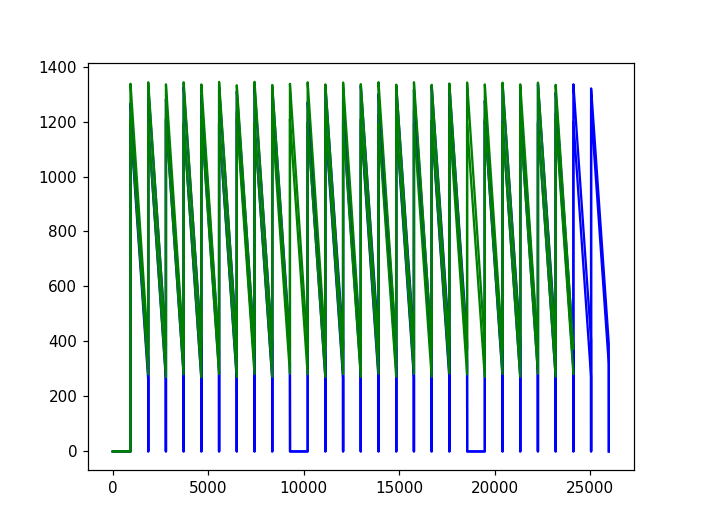

In [38]:
%matplotlib notebook

plt.plot(dia_data.dia_mz_cycle, c="b")
# plt.plot(dia_mz_cycle)
plt.plot(predicted_dia_mz_cycle, c="g")

# Plotting whole sample

In [ ]:
%matplotlib notebook

animation = animate_quad(
    dia_data,
#     save_path="sandbox_animation_calibrated_quad.gif",
    predicted_dia_mz_cycle=dia_data.predicted_dia_mz_cycle,
)

In [39]:
%%time

(
    merged_indptr,
    merged_tof_indices,
    merged_intensity_values,
) = merge_all(dia_data)

(
    merged_indptr,
    merged_tof_indices,
    merged_intensity_values,
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25984/25984 [00:25<00:00, 1015.53it/s]


CPU times: user 24.5 s, sys: 20.7 s, total: 45.2 s
Wall time: 45.9 s


(array([        0,         0,         0, ..., 316745737, 316745921,
        316745921]),
 array([  4988,   7650,  12532, ..., 278128, 297464, 358321], dtype=uint32),
 array([73., 11., 10., ..., 10., 12., 10.]))

In [ ]:
plots = {}
for cycle_frame in range(cycle_length // dia_data.scan_max_index):
# for cycle_frame in range(1, 3):
    plot = plot_frame(
        merged_indptr,
        merged_tof_indices,
        merged_intensity_values,
        dia_data=dia_data,
        cycle_frame=cycle_frame,
    )
    polys = plot_quad(
        cycle_frame,
        dia_data,
        dia_data.dia_mz_cycle,
        color="green"
    )
    polys2 = plot_quad(
        cycle_frame,
        dia_data,
        dia_data.predicted_dia_mz_cycle,
        color="white",
    )
    plots[cycle_frame] = plot * polys * polys2
#     plots[cycle_frame] = plot

In [ ]:
total_plot = (
    functools.reduce(lambda a, b: a + b, plots.values())
).cols(4)

total_plot

# Plotting individual cycles

In [40]:
cycle_index = 0

In [41]:
start_push_index = dia_data.zeroth_frame * dia_data.scan_max_index + cycle_index * len(dia_data.dia_mz_cycle)
end_push_index = start_push_index + cycle_length
raw_indptr = dia_data.push_indptr[start_push_index: end_push_index + 1].copy()
raw_tof_indices = dia_data.tof_indices[raw_indptr[0]: raw_indptr[-1]]
raw_intensity_values = dia_data.intensity_values[raw_indptr[0]: raw_indptr[-1]].astype(np.float32)
raw_indptr -= raw_indptr[0]

(
    raw_indptr,
    raw_tof_indices,
    raw_intensity_values,
)

(array([     0,      0,      0, ..., 142961, 142962, 142962]),
 array([230254,  36473, 253502, ..., 118308,    268, 114712], dtype=uint32),
 array([  10.,   11.,  275., ..., 1002.,   10.,  435.], dtype=float32))

In [44]:
plots = {}
for cycle_frame in range(cycle_length // dia_data.scan_max_index):
# for cycle_frame in range(1, 3):
    plot = plot_frame(
        raw_indptr,
        raw_tof_indices,
        raw_intensity_values,
        dia_data=dia_data,
        cycle_frame=cycle_frame,
    )
    polys = plot_quad(
        cycle_frame,
        dia_data,
        dia_data.dia_mz_cycle,
        color="blue"
    )
    polys2 = plot_quad(
        cycle_frame,
        dia_data,
        dia_data.predicted_dia_mz_cycle,
        color="white",
    )
    plots[cycle_frame] = plot * polys * polys2

IndexError: index 24128 is out of bounds for axis 0 with size 24128

In [45]:
total_plot = (
    functools.reduce(lambda a, b: a + b, plots.values())
).cols(4)

total_plot

:Layout
   .DynamicMap.I     :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.II    :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.III   :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.IV    :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.V     :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.VI    :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.VII   :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.VIII  :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.IX    :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.X     :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XI    :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XII   :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XIII  :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XIV   :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XV    :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XVI   :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XVII  :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XVIII :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XIX   :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XX    :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XXI   :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polygons   [x,y]
   .DynamicMap.XXII  :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [mz,im]   (R,G,B,A)
         .Polygons.I  :Polygons   [x,y]
         .Polygons.II :Polyg